In [ ]:
#import libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

#reading data from CSV file to a Pandas DataFrame
df = pd.read_csv("/content/brca.csv")


This dataset carries the lab analysis of breast tumors.

The columns represent the data as described below:

- y: The outcomes. A factor with two levels denoting whether a mass is malignant ("M") or benign ("B").

- x: The predictors. A matrix with the mean, standard error and worst value of each of 10 nuclear measurements on the slide, for 30 total features per biopsy:

- radius: Nucleus radius (mean of distances from center to points on perimeter).
texture. Nucleus texture (standard deviation of grayscale values).

- perimeter: Nucleus perimeter.

- area: Nucleus area.

- smoothness: Nucleus smoothness (local variation in radius lengths).

- compactness: Nucleus compactness (perimeter^2/area - 1).

- concavity: Nucleus concavity (severity of concave portions of the contour).

- concave_pts: Number of concave portions of the nucleus contour.

- symmetry: Nucleus symmetry.

- fractal_dim: Nucleus fractal dimension ("coastline approximation" -1).

Column Description as obtained from source:

- x.radius_mean:	Mean radius of the tumor cells

- x.radius_mean:	Mean radius of the tumor cells

- x.texture_mean:	Mean texture of the tumor cells

- x.perimeter_mean:	Mean perimeter of the tumor cells

- x.area_mean:	Mean area of the tumor cells

- x.smoothness_mean:	Mean smoothness of the tumor cells

- x.compactness_mean:	Mean compactness of the tumor cells

- x.concavity_mean:	Mean concavity of the tumor cells

- x.concave_points_mean:	Mean number of concave portions of the contour of the tumor cells

- x.symmetry_mean	Mean: symmetry of the tumor cells

- x.fractal_dimension_mean:	Mean "coastline approximation" of the tumor cells

- x.radius_se:	Standard error of the radius of the tumor cells

- x.texture_se:	Standard error of the texture of the tumor cells

- x.perimeter_se:	Standard error of the perimeter of the tumor cells

- x.area_se:	Standard error of the area of the tumor cells

- x.smoothness_se:	Standard error of the smoothness of the tumor cells

- x.compactness_se:	Standard error of the compactness of the tumor cells

- x.concavity_se:	Standard error of the concavity of the tumor cells

- x.concave_points_se:	Standard error of the number of concave portions of the contour of the tumor cells

- x.symmetry_se:	Standard error of the symmetry of the tumor cells

- x.fractal_dimension_se:	Standard error of the "coastline approximation" of the tumor cells
x.radius_worst	Worst (largest) radius of the tumor cells

- x.texture_worst:	Worst (most severe) texture of the tumor cells

- x.perimeter_worst: 	Worst (largest) perimeter of the tumor cells

- x.area_worst:	Worst (largest) area of the tumor cells

- x.smoothness_worst:	Worst (most severe) smoothness of the tumor cells

- x.compactness_worst:	Worst (most severe) compactness of the tumor cells

- x.concavity_worst:	Worst (most severe) concavity of the tumor cells

- x.concave_points_worst:	Worst (most severe) number of concave portions of the contour of the tumor cells

- x.symmetry_worst:	Worst (most severe) symmetry of the tumor cells

- x.fractal_dimension_worst:	Worst (most severe) "coastline approximation" of the tumor cells
y	target

In [ ]:
#To Know total number of rows, columns (name, datatypes and null values)
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Unnamed: 0           569 non-null    int64  
 1   x.radius_mean        569 non-null    float64
 2   x.texture_mean       569 non-null    float64
 3   x.perimeter_mean     569 non-null    float64
 4   x.area_mean          569 non-null    float64
 5   x.smoothness_mean    569 non-null    float64
 6   x.compactness_mean   569 non-null    float64
 7   x.concavity_mean     569 non-null    float64
 8   x.concave_pts_mean   569 non-null    float64
 9   x.symmetry_mean      569 non-null    float64
 10  x.fractal_dim_mean   569 non-null    float64
 11  x.radius_se          569 non-null    float64
 12  x.texture_se         569 non-null    float64
 13  x.perimeter_se       569 non-null    float64
 14  x.area_se            569 non-null    float64
 15  x.smoothness_se      569 non-null    flo

In [ ]:
#df.head()
df.iloc[:5,:10]

,Unnamed: 0,x.radius_mean,x.texture_mean,x.perimeter_mean,x.area_mean,x.smoothness_mean,x.compactness_mean,x.concavity_mean,x.concave_pts_mean,x.symmetry_mean
0,1,13.540,14.36,87.46,566.3,0.09779,0.08129,0.06664,0.047810,0.1885
1,2,13.080,15.71,85.63,520.0,0.10750,0.12700,0.04568,0.031100,0.1967
2,3,9.504,12.44,60.34,273.9,0.10240,0.06492,0.02956,0.020760,0.1815
3,4,13.030,18.42,82.61,523.8,0.08983,0.03766,0.02562,0.029230,0.1467
4,5,8.196,16.84,51.71,201.9,0.08600,0.05943,0.01588,0.005917,0.1769


In [ ]:
df.iloc[:5,10:20]

,x.fractal_dim_mean,x.radius_se,x.texture_se,x.perimeter_se,x.area_se,x.smoothness_se,x.compactness_se,x.concavity_se,x.concave_pts_se,x.symmetry_se
0,0.05766,0.2699,0.7886,2.058,23.560,0.008462,0.014600,0.02387,0.013150,0.01980
1,0.06811,0.1852,0.7477,1.383,14.670,0.004097,0.018980,0.01698,0.006490,0.01678
2,0.06905,0.2773,0.9768,1.909,15.700,0.009606,0.014320,0.01985,0.014210,0.02027
3,0.05863,0.1839,2.3420,1.170,14.160,0.004352,0.004899,0.01343,0.011640,0.02671
4,0.06503,0.1563,0.9567,1.094,8.205,0.008968,0.016460,0.01588,0.005917,0.02574


In [ ]:
df.iloc[:5,20:32]

,x.fractal_dim_se,x.radius_worst,x.texture_worst,x.perimeter_worst,x.area_worst,x.smoothness_worst,x.compactness_worst,x.concavity_worst,x.concave_pts_worst,x.symmetry_worst,x.fractal_dim_worst,y
0,0.002300,15.110,19.26,99.70,711.2,0.14400,0.17730,0.23900,0.12880,0.2977,0.07259,B
1,0.002425,14.500,20.49,96.09,630.5,0.13120,0.27760,0.18900,0.07283,0.3184,0.08183,B
2,0.002968,10.230,15.66,65.13,314.9,0.13240,0.11480,0.08867,0.06227,0.2450,0.07773,B
3,0.001777,13.300,22.81,84.46,545.9,0.09701,0.04619,0.04833,0.05013,0.1987,0.06169,B
4,0.002582,8.964,21.96,57.26,242.2,0.12970,0.13570,0.06880,0.02564,0.3105,0.07409,B


**Column Unnamed to be dropped.**

In [ ]:
df.drop('Unnamed: 0',axis=1,inplace=True)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   x.radius_mean        569 non-null    float64
 1   x.texture_mean       569 non-null    float64
 2   x.perimeter_mean     569 non-null    float64
 3   x.area_mean          569 non-null    float64
 4   x.smoothness_mean    569 non-null    float64
 5   x.compactness_mean   569 non-null    float64
 6   x.concavity_mean     569 non-null    float64
 7   x.concave_pts_mean   569 non-null    float64
 8   x.symmetry_mean      569 non-null    float64
 9   x.fractal_dim_mean   569 non-null    float64
 10  x.radius_se          569 non-null    float64
 11  x.texture_se         569 non-null    float64
 12  x.perimeter_se       569 non-null    float64
 13  x.area_se            569 non-null    float64
 14  x.smoothness_se      569 non-null    float64
 15  x.compactness_se     569 non-null    flo

**There are No Null values in any of the columns as visible from the info of DataFrame.**

**Check for duplicates.**

In [ ]:
df[df.duplicated()].shape

(0, 31)

**No Duplicates found.**

In [ ]:
#Describing only the numerical Columns
#Target Column Y is of Object TYpe and will be checked seperately
#df.describe()
df.iloc[:,:10].describe()

,x.radius_mean,x.texture_mean,x.perimeter_mean,x.area_mean,x.smoothness_mean,x.compactness_mean,x.concavity_mean,x.concave_pts_mean,x.symmetry_mean,x.fractal_dim_mean
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440


In [ ]:
df.iloc[:,10:20].describe()

,x.radius_se,x.texture_se,x.perimeter_se,x.area_se,x.smoothness_se,x.compactness_se,x.concavity_se,x.concave_pts_se,x.symmetry_se,x.fractal_dim_se
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,0.405172,1.216853,2.866059,40.337079,0.007041,0.025478,0.031894,0.011796,0.020542,0.003795
std,0.277313,0.551648,2.021855,45.491006,0.003003,0.017908,0.030186,0.006170,0.008266,0.002646
min,0.111500,0.360200,0.757000,6.802000,0.001713,0.002252,0.000000,0.000000,0.007882,0.000895
25%,0.232400,0.833900,1.606000,17.850000,0.005169,0.013080,0.015090,0.007638,0.015160,0.002248
50%,0.324200,1.108000,2.287000,24.530000,0.006380,0.020450,0.025890,0.010930,0.018730,0.003187
75%,0.478900,1.474000,3.357000,45.190000,0.008146,0.032450,0.042050,0.014710,0.023480,0.004558
max,2.873000,4.885000,21.980000,542.200000,0.031130,0.135400,0.396000,0.052790,0.078950,0.029840


In [ ]:
df.iloc[:,20:30].describe()

,x.radius_worst,x.texture_worst,x.perimeter_worst,x.area_worst,x.smoothness_worst,x.compactness_worst,x.concavity_worst,x.concave_pts_worst,x.symmetry_worst,x.fractal_dim_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [ ]:
#Descriing the Target Y column
df.describe(include='object')

,y
count,569
unique,2
top,B
freq,357


**Out of the total 569 cases, 357 cases are benign.**

In [ ]:
df['y'].value_counts()

y
B    357
M    212
Name: count, dtype: int64

In [ ]:
#A glance at the visualization on distribution and correlation using pair plot
sns.pairplot(df,hue='y')
plt.show()

In [ ]:
#Replacing values of Y to 0 and 1 so that it wont interfere while calculating correlation matrix
data=df.copy()
data.y=data.y.replace(['B', 'M'],[0,1])
#0-Benign
#1-Malignant
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   x.radius_mean        569 non-null    float64
 1   x.texture_mean       569 non-null    float64
 2   x.perimeter_mean     569 non-null    float64
 3   x.area_mean          569 non-null    float64
 4   x.smoothness_mean    569 non-null    float64
 5   x.compactness_mean   569 non-null    float64
 6   x.concavity_mean     569 non-null    float64
 7   x.concave_pts_mean   569 non-null    float64
 8   x.symmetry_mean      569 non-null    float64
 9   x.fractal_dim_mean   569 non-null    float64
 10  x.radius_se          569 non-null    float64
 11  x.texture_se         569 non-null    float64
 12  x.perimeter_se       569 non-null    float64
 13  x.area_se            569 non-null    float64
 14  x.smoothness_se      569 non-null    float64
 15  x.compactness_se     569 non-null    flo

In [ ]:
corr_matrix = data.corr()

#Correlation helps to find the relationship between two columns on the dataset
#Below code snippet arranges the pair of columns in the descending order of abso;ute value of correlation

# Reshape the correlation matrix to a long format and reset the index
corr_pairs = corr_matrix.unstack().reset_index()

# Rename the columns for clarity
corr_pairs.columns = ['Feature1', 'Feature2', 'Correlation']

# Remove self correlations
corr_pairs = corr_pairs[corr_pairs['Feature1'] != corr_pairs['Feature2']]

# Sort the correlation pairs by absolute value of correlation
corr_pairs = corr_pairs.sort_values(by='Correlation', key=abs, ascending=False)

# Extract the top correlation pairs
top_pairs = corr_pairs.drop_duplicates(subset=['Correlation']).head(50)

# Display the top correlation pairs
print("Top Correlation Pairs:")
print(top_pairs.to_string())


Top Correlation Pairs:
                Feature1             Feature2  Correlation
2          x.radius_mean     x.perimeter_mean     0.997855
702    x.perimeter_worst       x.radius_worst     0.993708
93           x.area_mean        x.radius_mean     0.987357
95           x.area_mean     x.perimeter_mean     0.986507
733         x.area_worst       x.radius_worst     0.984015
735         x.area_worst    x.perimeter_worst     0.977578
382       x.perimeter_se          x.radius_se     0.972794
684    x.perimeter_worst     x.perimeter_mean     0.970387
620       x.radius_worst        x.radius_mean     0.969539
622       x.radius_worst     x.perimeter_mean     0.969476
22         x.radius_mean    x.perimeter_worst     0.965137
623       x.radius_worst          x.area_mean     0.962746
116          x.area_mean         x.area_worst     0.959213
685    x.perimeter_worst          x.area_mean     0.959120
323          x.radius_se            x.area_se     0.951830
715         x.area_worst     x.pe

**From the Pair plot and the Correlation matrix, we can see that there is strong positive linear correlations visible among the x data columns.**

**But there are skewness visible. Lets check for Outliers though in the case of this dataset we have limited access to impute the outliers.**

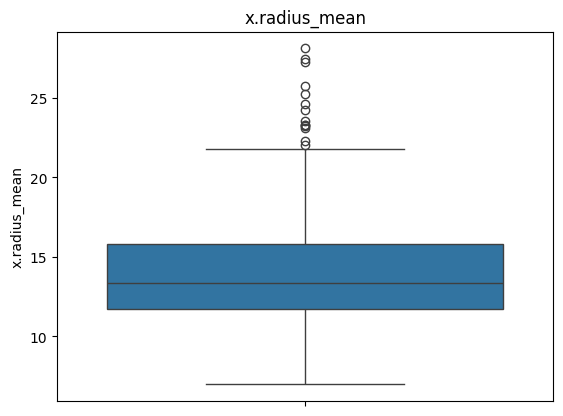

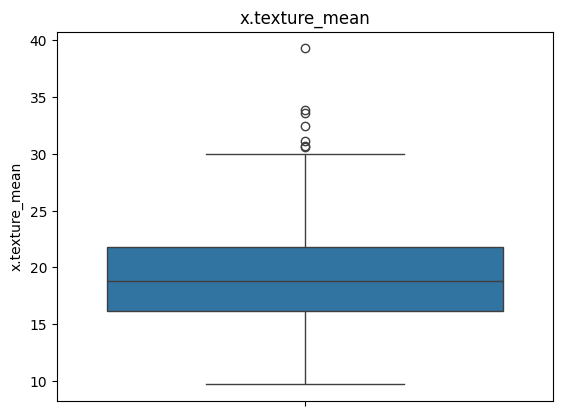

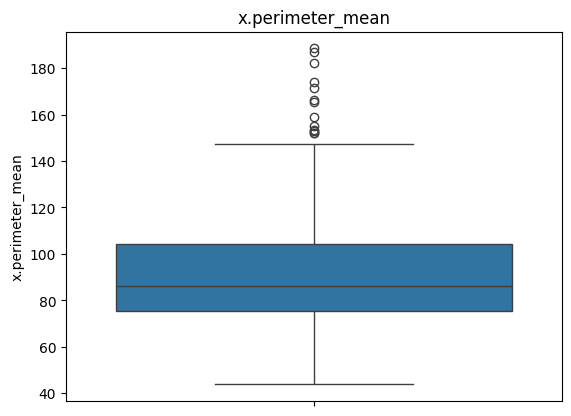

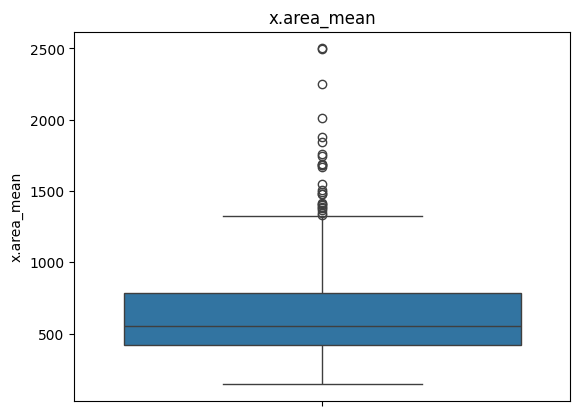

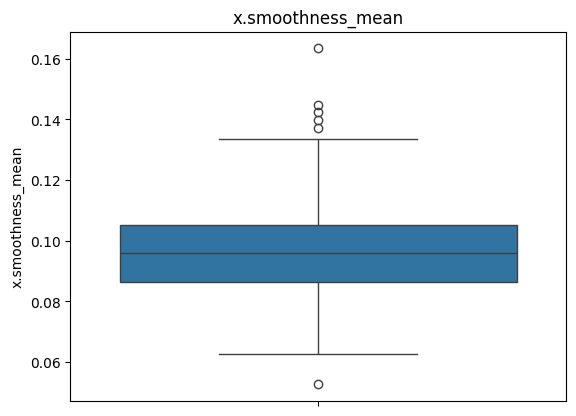

...

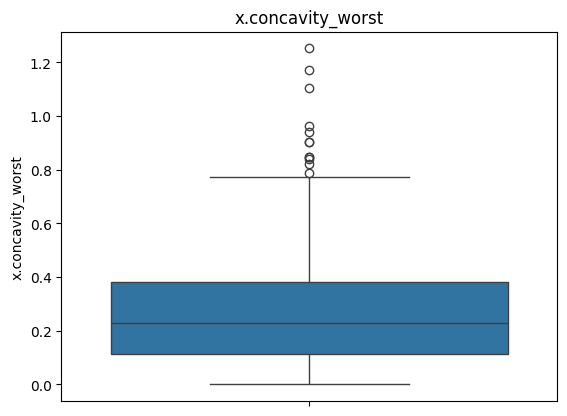

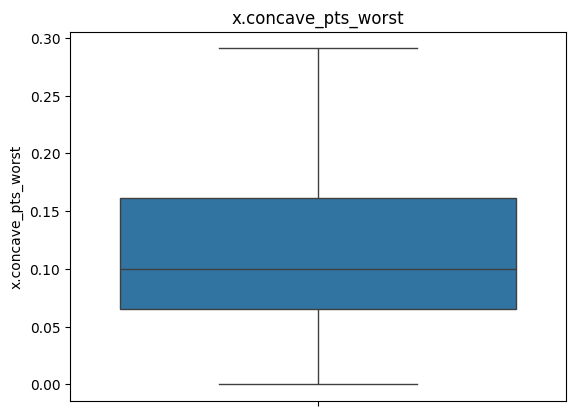

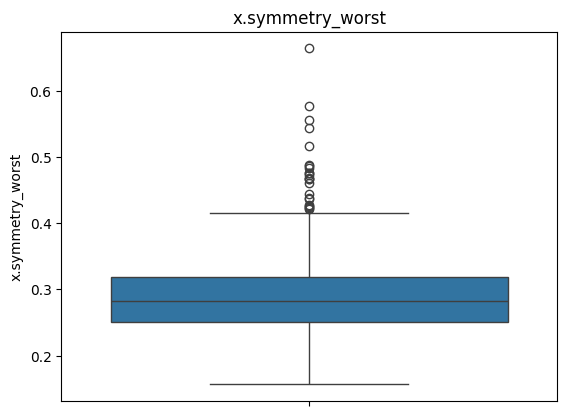

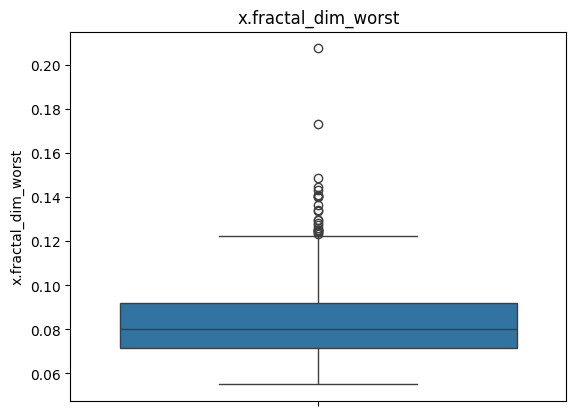

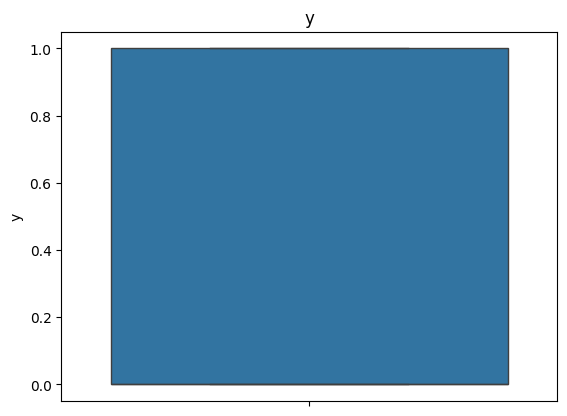

In [ ]:
#Checking Outliers
#plt.figure(figsize=(10, 15))
for i, column in enumerate(data, 1):
    sns.boxplot(y=data[column])
    plt.title(column)
    plt.show()


**There are only 2 columns without outliers - x.concave_pts_worst and y column.**

**As I am not convinced to remove or impute the outliers at this point in time for this dataset, trying to reduce the skewness.**

Will try imputing it later for self study.

In [ ]:
#Checking the Skewness score for the columns
#Skewness is the check of assymmetry of the distribution
#Addressing skewness can bring the distribution nearly to a normal distribution
#this will have good impact on the machine learning model

old_skew = data.skew()#saving initial skewness

print(old_skew)

x.radius_mean          0.942380
x.texture_mean         0.650450
x.perimeter_mean       0.990650
x.area_mean            1.645732
x.smoothness_mean      0.456324
x.compactness_mean     1.190123
x.concavity_mean       1.401180
x.concave_pts_mean     1.171180
x.symmetry_mean        0.725609
x.fractal_dim_mean     1.304489
x.radius_se            3.088612
x.texture_se           1.646444
x.perimeter_se         3.443615
x.area_se              5.447186
x.smoothness_se        2.314450
x.compactness_se       1.902221
x.concavity_se         5.110463
x.concave_pts_se       1.444678
x.symmetry_se          2.195133
x.fractal_dim_se       3.923969
x.radius_worst         1.103115
x.texture_worst        0.498321
x.perimeter_worst      1.128164
x.area_worst           1.859373
x.smoothness_worst     0.415426
x.compactness_worst    1.473555
x.concavity_worst      1.150237
x.concave_pts_worst    0.492616
x.symmetry_worst       1.433928
x.fractal_dim_worst    1.662579
y                      0.528461
dtype: f

**Addressing skewness with Log Transformation as its the best transformation for Right Skewed Data.**

# Sample Code - Run as needed

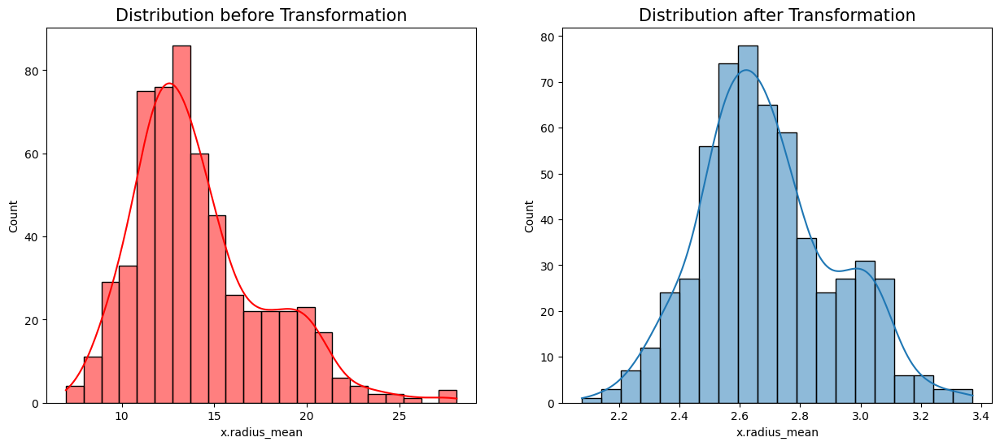

Skewness was 0.94 before & is 0.35 after Log transformation.


In [ ]:
#this is the sample code used to check the distribution with histogram and kdeplot

from sklearn.preprocessing import FunctionTransformer
from sklearn.compose import ColumnTransformer

# function to apply transformer and check the distribution with histogram and kdeplot
def logTrans(feature):

    logTr = ColumnTransformer(transformers=[("lg", FunctionTransformer(np.log1p), [feature])])

    plt.figure(figsize=(15,6))
    plt.subplot(1,2,1)
    plt.title("Distribution before Transformation", fontsize=15)
    sns.histplot(data[feature], kde=True, color="red")
    plt.subplot(1,2,2)

    df_log = pd.DataFrame(logTr.fit_transform(data))
    plt.title("Distribution after Transformation", fontsize=15)
    sns.histplot(df_log,bins=20, kde=True , legend=False)
    plt.xlabel(feature)
    plt.show()

    print(f"Skewness was {round(old_skew[feature],2)} before & is {round(df_log.skew()[0],2)} after Log transformation.")
logTrans(feature="x.radius_mean")
#logTrans(feature="x.texture_mean")
#logTrans(feature="x.area_mean")
#logTrans(feature="x.perimeter_mean")
#logTrans(feature="x.smoothness_mean")
#logTrans(feature="x.compactness_mean")
#logTrans(feature="x.concavity_mean")
#logTrans(feature="x.concave_pts_mean")
#logTrans(feature="x.symmetry_mean")
#logTrans(feature="x.fractal_dim_mean")
#logTrans(feature="x.radius_se")
#logTrans(feature="x.texture_se")
#logTrans(feature="x.perimeter_se")
#logTrans(feature="x.area_se")
#logTrans(feature="x.smoothness_se")
#logTrans(feature="x.compactness_se")
#logTrans(feature="x.concavity_se")#4.23
#logTrans(feature="x.concave_pts_se")#No improvement
#logTrans(feature="x.symmetry_se")#minor improvement 2.14
#logTrans(feature="x.fractal_dim_se")#minor improvement 3.92
#logTrans(feature="x.radius_worst")
#logTrans(feature="x.texture_worst")#negligible left skew induced
#logTrans(feature="x.perimeter_worst")
#logTrans(feature="x.area_worst")
#logTrans(feature="x.smoothness_worst")
#logTrans(feature="x.compactness_worst")
#logTrans(feature="x.concavity_worst")
#logTrans(feature="x.concave_pts_worst")
#logTrans(feature="x.symmetry_worst")
#logTrans(feature="x.fractal_dim_worst")
#logTrans(feature="y")

# Log Transformation

**With the above code snippet, checked the impact of Log transformation on the columns which are all Right Skewed or Positively skewed.**

**After checking colum by column, convinced that the skewness can be reduced and hence applying the Log Transformation at once on the dataset.**

In [ ]:
from sklearn.preprocessing import FunctionTransformer
from sklearn.compose import ColumnTransformer

# Define the log transformation
log_transformer = FunctionTransformer(np.log1p, validate=True)

#Transforming all columns except the target column
df_features = data.iloc[:, :-1]

# Apply the transformation to the dataframe
df_log_transformed = log_transformer.transform(df_features)

# Convert the result array back to a dataframe
df_log_transformed = pd.DataFrame(df_log_transformed, columns=df_features.columns)

df_log_transformed.skew()

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but FunctionTransformer was fitted without feature names
  warnings.warn(


x.radius_mean          0.348744
x.texture_mean         0.018733
x.perimeter_mean       0.328800
x.area_mean            0.287328
x.smoothness_mean      0.406548
x.compactness_mean     1.043195
x.concavity_mean       1.206982
x.concave_pts_mean     1.083180
x.symmetry_mean        0.632718
x.fractal_dim_mean     1.272294
x.radius_se            1.713417
x.texture_se           0.629526
x.perimeter_se         1.025375
x.area_se              0.847298
x.smoothness_se        2.283394
x.compactness_se       1.816278
x.concavity_se         4.231738
x.concave_pts_se       1.399869
x.symmetry_se          2.135874
x.fractal_dim_se       3.874373
x.radius_worst         0.506347
x.texture_worst       -0.101178
x.perimeter_worst      0.462758
x.area_worst           0.457614
x.smoothness_worst     0.346313
x.compactness_worst    1.048729
x.concavity_worst      0.717939
x.concave_pts_worst    0.386721
x.symmetry_worst       1.152984
x.fractal_dim_worst    1.558559
dtype: float64

In [ ]:
new_skew = df_log_transformed.skew()

#Creating a dictionary of Old and New Skewness Values
data_dic = {'Old_Skew': old_skew,
                'New_Skew': new_skew}

#COnverting it to a DataFrame
df_skew_comp = pd.DataFrame(data_dic)

#Assigning the Feature names as the Row Index
df_skew_comp.index = data.columns

#Print the result
df_skew_comp

,Old_Skew,New_Skew
x.radius_mean,1.645732,0.287328
x.texture_mean,5.447186,0.847298
x.perimeter_mean,1.859373,0.457614
x.area_mean,1.190123,1.043195
x.smoothness_mean,1.902221,1.816278
x.compactness_mean,1.473555,1.048729
x.concavity_mean,1.171180,1.083180
x.concave_pts_mean,1.444678,1.399869
x.symmetry_mean,0.492616,0.386721
x.fractal_dim_mean,1.401180,1.206982


**There is a considerable descrease on the skewness of each column.**

# Normalization

In [ ]:
# Normalizing numerical variables
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
data_normalized = df_log_transformed.copy()
data_normalized[data_normalized.columns] = sc.fit_transform(data_normalized[data_normalized.columns])

In [ ]:
data_normalized_copy = data_normalized.copy()
data_normalized_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 30 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   x.radius_mean        569 non-null    float64
 1   x.texture_mean       569 non-null    float64
 2   x.perimeter_mean     569 non-null    float64
 3   x.area_mean          569 non-null    float64
 4   x.smoothness_mean    569 non-null    float64
 5   x.compactness_mean   569 non-null    float64
 6   x.concavity_mean     569 non-null    float64
 7   x.concave_pts_mean   569 non-null    float64
 8   x.symmetry_mean      569 non-null    float64
 9   x.fractal_dim_mean   569 non-null    float64
 10  x.radius_se          569 non-null    float64
 11  x.texture_se         569 non-null    float64
 12  x.perimeter_se       569 non-null    float64
 13  x.area_se            569 non-null    float64
 14  x.smoothness_se      569 non-null    float64
 15  x.compactness_se     569 non-null    flo

In [ ]:
data_normalized.head()

,x.radius_mean,x.texture_mean,x.perimeter_mean,x.area_mean,x.smoothness_mean,x.compactness_mean,x.concavity_mean,x.concave_pts_mean,x.symmetry_mean,x.fractal_dim_mean,...,x.radius_worst,x.texture_worst,x.perimeter_worst,x.area_worst,x.smoothness_worst,x.compactness_worst,x.concavity_worst,x.concave_pts_worst,x.symmetry_worst,x.fractal_dim_worst
0,-0.064545,-1.225581,-0.073082,-0.050267,0.108354,-0.428925,-0.257499,-0.010841,0.280659,-0.729851,...,-0.131562,-1.077266,-0.101526,-0.088482,0.519162,-0.478786,-0.091203,0.246543,0.150265,-0.632624
1,-0.209337,-0.822965,-0.157336,-0.226957,0.797267,0.459481,-0.540805,-0.454491,0.579399,0.757704,...,-0.279932,-0.822012,-0.228324,-0.305683,-0.041378,0.218291,-0.358056,-0.626368,0.490143,-0.110617
2,-1.528969,-1.863776,-1.548712,-1.553807,0.436184,-0.756250,-0.762582,-0.732633,0.024001,0.890798,...,-1.518586,-1.924534,-1.562089,-1.556703,0.011442,-0.943864,-0.929156,-0.796159,-0.740115,-0.341691
3,-0.225359,-0.104645,-0.300350,-0.211875,-0.460959,-1.312655,-0.817316,-0.504586,-1.274958,-0.591155,...,-0.589663,-0.378028,-0.671469,-0.565455,-1.570312,-1.485431,-1.173765,-0.993453,-1.554036,-1.254223
4,-2.127928,-0.510224,-2.159841,-2.184073,-0.736371,-0.867152,-0.953530,-1.136870,-0.145490,0.320784,...,-1.978337,-0.535461,-2.002167,-2.029068,-0.107481,-0.785502,-1.048487,-1.398491,0.361065,-0.547577


# Pre Processing

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

#X = data_normalized_copy.drop('y', axis=1)
X = data_normalized_copy
y = df['y']

# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Fit and transform the target variable
y_encoded = label_encoder.fit_transform(y)

X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)


# Linear Regression

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

# Create a LinearRegression object
model = LinearRegression()

# Train the model using the training sets
model.fit(X_train, y_train)


LinearRegression()

In [ ]:
# Make predictions using the testing set
y_pred = model.predict(X_test)

# The coefficients
print('Coefficients:', model.coef_)
# The intercept
print('Intercept:', model.intercept_)

# Mean squared error
mse = mean_squared_error(y_test, y_pred)
print('Mean squared error:', mse)

# R^2 score: 1 is perfect prediction
r2 = r2_score(y_test, y_pred)
print('R^2 score:', r2)

Coefficients: [-1.18963579e-01  1.66209139e-02  6.25455061e-01 -4.98962551e-01
 -4.40438203e-03 -2.11119354e-01  1.71961474e-01  3.76835041e-02
 -1.41103407e-02  1.24925267e-02 -1.14401522e-01 -2.11707662e-02
 -6.41471358e-02  3.71177899e-01  2.13654115e-02 -1.36331351e-03
 -1.40871376e-01  6.28421431e-02  8.52755400e-03 -1.90427531e-02
 -2.00616008e-01  5.91266257e-02  2.72328754e-02  1.99683455e-01
  1.31915227e-02 -4.71144527e-04  7.95691855e-02  5.15746180e-02
  6.07227529e-02  7.59025502e-02]
Intercept: 0.3734289144882415
Mean squared error: 0.051172080111600536
R^2 score: 0.7821708636978839


**R^2 score close to 1 suggest a strong model.**

**Low MSE indicates that the model's predictions are close to the actual values, suggesting a good fit.**

**Lets check with Logistic Regression and then do a comparison.**

In [ ]:
y_pred

array([ 2.11781225e-01, -5.38098903e-02, -1.82271051e-01,  6.42420522e-01,
        1.04337988e+00,  6.03779253e-01,  7.00510968e-01,  2.85549345e-01,
        3.13636140e-02,  1.29495001e+00,  8.11102143e-01, -2.26422680e-01,
       -3.05112749e-01,  7.75153555e-02,  8.74354459e-01, -1.74712859e-01,
        9.08098200e-01,  4.34410672e-01,  6.29428875e-02,  1.02543620e+00,
        2.79083000e-01,  4.89660750e-01,  3.20706099e-01,  9.10865797e-01,
        2.42457454e-01,  2.25118095e-01,  1.11740769e+00,  8.64625893e-01,
        7.66278443e-01,  1.72183943e-01,  1.06305576e+00, -6.60185666e-02,
        1.37310088e+00,  5.86030139e-01, -1.24835263e-02,  3.18982583e-01,
        2.27282487e-01,  1.08560664e-01,  3.15334373e-01,  1.65889423e-01,
        1.56448761e-02,  1.79962903e-01,  6.43370891e-01,  1.92659453e-01,
        1.12733265e-01, -2.36901310e-01,  1.11163589e+00,  9.36887497e-01,
        8.15237104e-01,  1.58258464e-01,  3.44119198e-01,  2.61896629e-01,
       -2.31683566e-01,  

In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# Convert prediction to binary class labels using a threshold (e.g., 0.5)
threshold = 0.5
y_pred_binary = (y_pred >= threshold).astype(int)

accuracy = accuracy_score(y_test, y_pred_binary)
conf_matrix = confusion_matrix(y_test, y_pred_binary)
class_report = classification_report(y_test, y_pred_binary, target_names=label_encoder.classes_)
print('Accuracy:\n',accuracy)
print('\nConfusion Matrix:\n', conf_matrix)
print('\nClassification Report:\n', class_report)



Accuracy:
 0.9649122807017544

Confusion Matrix:
 [[71  0]
 [ 4 39]]

Classification Report:
               precision    recall  f1-score   support

           B       0.95      1.00      0.97        71
           M       1.00      0.91      0.95        43

    accuracy                           0.96       114
   macro avg       0.97      0.95      0.96       114
weighted avg       0.97      0.96      0.96       114



# Logistic Regression

In [ ]:
from sklearn.linear_model import LogisticRegression

# Create a LogisticRegression object
model_lr = LogisticRegression()

# Train the model using the training sets
model_lr.fit(X_train, y_train)

# Make predictions using the testing set
y_pred_prob = model_lr.predict_proba(X_test)[:, 1]  # Get probabilities for the positive class

# Mean squared error
mse = mean_squared_error(y_test, y_pred_prob)
print('\nMean squared error:', mse)

# R^2 score: 1 is perfect prediction
r2 = r2_score(y_test, y_pred_prob)
print('\nR^2 score:', r2)

# Convert probabilities to binary class labels using a threshold (e.g., 0.5)
threshold = 0.5
y_pred = (y_pred_prob >= threshold).astype(int)

# Evaluate the model using classification metrics
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred, target_names=label_encoder.classes_)

print('\nAccuracy:', accuracy)
print('\nConfusion Matrix:\n', conf_matrix)
print('\nClassification Report:\n', class_report)



Mean squared error: 0.02745830801484046

R^2 score: 0.8831155679787531

Accuracy: 0.9649122807017544

Confusion Matrix:
 [[69  2]
 [ 2 41]]

Classification Report:
               precision    recall  f1-score   support

           B       0.97      0.97      0.97        71
           M       0.95      0.95      0.95        43

    accuracy                           0.96       114
   macro avg       0.96      0.96      0.96       114
weighted avg       0.96      0.96      0.96       114



# Summary

On checking the data using the pair plot, correlation was evident along with skewness. Since its the medical data carefully curated, did not want to alter the outliers. Just wanted to get in control of the skewness so that we get better result from the model.

Chose to work with Linear Regression and Logistic Regression.

Linerar Regression is of predicting the a continuous target (dependant) variable, where as Logistic Regression is a classification model.

Mean Squared Error and R^2 values are comparitively better for Logistic Regression model than the Linear Regression Model. But the Accuracy is the same. Hence looking at the Confusion Matrix.

From the above work of self study we can see that both the model gave same Accuracy but Linear Regression came out with Zero Type 1 and Four Type 2 errors, while Logistic Regression had 2 errors each for Type 1 and Type 2.

From the understanding of the learning of Type 1 and Type 2 errors its ok to have Type 2 errors but not Type 1 errors.

Hence prefering Linear Regression over Logistic Regression in this case.